In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
from sklearn.svm import SVC
import scipy.stats as stats
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, StratifiedKFold
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import recall_score, classification_report
from sklearn.tree import DecisionTreeClassifier

In [ ]:
diabetes = pd.read_csv('diabetes_prediction_dataset.csv')

In [ ]:
diabetes

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99995,Female,80.0,0,0,No Info,27.32,6.2,90,0
99996,Female,2.0,0,0,No Info,17.37,6.5,100,0
99997,Male,66.0,0,0,former,27.83,5.7,155,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0


In [ ]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   gender               100000 non-null  object 
 1   age                  100000 non-null  float64
 2   hypertension         100000 non-null  int64  
 3   heart_disease        100000 non-null  int64  
 4   smoking_history      100000 non-null  object 
 5   bmi                  100000 non-null  float64
 6   HbA1c_level          100000 non-null  float64
 7   blood_glucose_level  100000 non-null  int64  
 8   diabetes             100000 non-null  int64  
dtypes: float64(3), int64(4), object(2)
memory usage: 6.9+ MB


In [ ]:
diabetes.describe()

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes
count,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,41.885856,0.07485,0.039420,27.320767,5.527507,138.058060,0.085000
std,22.516840,0.26315,0.194593,6.636783,1.070672,40.708136,0.278883
min,0.080000,0.00000,0.000000,10.010000,3.500000,80.000000,0.000000
25%,24.000000,0.00000,0.000000,23.630000,4.800000,100.000000,0.000000
50%,43.000000,0.00000,0.000000,27.320000,5.800000,140.000000,0.000000
75%,60.000000,0.00000,0.000000,29.580000,6.200000,159.000000,0.000000
max,80.000000,1.00000,1.000000,95.690000,9.000000,300.000000,1.000000


## Przygotowanie i oczyszczenie danych

In [ ]:
# zaokrąglenie wartości float do góry + zamiana na int
diabetes['age'] = diabetes['age'].apply(lambda x: math.ceil(x))

In [ ]:
diabetes.describe()
# Predyspozycje do zachorowania na cukrzycę składa się z wielu czynników, nie można patrzeć jedynie na płeć, czy szczupła sylwetkę.
# Trzeba zwrócić uwagę też na inne czynniki, takie jak np. ciśnieine krwi, choroby serca, poziom glukozy, hemoglobina glikowana

,age,hypertension,heart_disease,bmi,HbA1c_level,blood_glucose_level,diabetes
count,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,41.895840,0.07485,0.039420,27.320767,5.527507,138.058060,0.085000
std,22.498818,0.26315,0.194593,6.636783,1.070672,40.708136,0.278883
min,1.000000,0.00000,0.000000,10.010000,3.500000,80.000000,0.000000
25%,24.000000,0.00000,0.000000,23.630000,4.800000,100.000000,0.000000
50%,43.000000,0.00000,0.000000,27.320000,5.800000,140.000000,0.000000
75%,60.000000,0.00000,0.000000,29.580000,6.200000,159.000000,0.000000
max,80.000000,1.00000,1.000000,95.690000,9.000000,300.000000,1.000000


In [ ]:
diabetes.duplicated().sum()

3926

In [ ]:
diabetes = diabetes.drop_duplicates()

In [ ]:
diabetes['age'].mean()
diabetes['age'].std()
upper = diabetes['age'].mean() + diabetes['age'].std()*3
lower = diabetes['age'].mean() - diabetes['age'].std()*3

In [ ]:
diabetes2 = diabetes[(diabetes['age']<upper) & (diabetes['age']>lower)]

In [ ]:
diabetes2

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80,0,1,never,25.19,6.6,140,0
1,Female,54,0,0,No Info,27.32,6.6,80,0
2,Male,28,0,0,never,27.32,5.7,158,0
3,Female,36,0,0,current,23.45,5.0,155,0
4,Male,76,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99994,Female,36,0,0,No Info,24.60,4.8,145,0
99996,Female,2,0,0,No Info,17.37,6.5,100,0
99997,Male,66,0,0,former,27.83,5.7,155,0
99998,Female,24,0,0,never,35.42,4.0,100,0


In [ ]:
diabetes['bmi'].mean()
diabetes['bmi'].std()
upper = diabetes['bmi'].mean() + diabetes['bmi'].std()*3
lower = diabetes['bmi'].mean() - diabetes['bmi'].std()*3

In [ ]:
diabetes2 = diabetes[(diabetes['bmi']<upper) & (diabetes['bmi']>lower)]

In [ ]:
diabetes2

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80,0,1,never,25.19,6.6,140,0
1,Female,54,0,0,No Info,27.32,6.6,80,0
2,Male,28,0,0,never,27.32,5.7,158,0
3,Female,36,0,0,current,23.45,5.0,155,0
4,Male,76,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99994,Female,36,0,0,No Info,24.60,4.8,145,0
99996,Female,2,0,0,No Info,17.37,6.5,100,0
99997,Male,66,0,0,former,27.83,5.7,155,0
99998,Female,24,0,0,never,35.42,4.0,100,0


In [ ]:
diabetes2['diabetes'].value_counts()

0    86726
1     8137
Name: diabetes, dtype: int64

In [ ]:
diabetes['diabetes'].value_counts()

0    87592
1     8482
Name: diabetes, dtype: int64

In [ ]:
diabetes['gender'].value_counts()

Female    56122
Male      39934
Other        18
Name: gender, dtype: int64

In [ ]:
other_diabetes = diabetes[diabetes['gender'] == 'Other']['diabetes']

In [ ]:
print(other_diabetes)

12669    0
14838    0
16702    0
18691    0
23266    0
31985    0
33805    0
34929    0
35006    0
40337    0
56238    0
66595    0
66887    0
67204    0
68484    0
71139    0
75302    0
75734    0
Name: diabetes, dtype: int64


In [ ]:
diabetes[diabetes['gender'] == 'Other']

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
12669,Other,10,0,0,not current,14.09,5.0,140,0
14838,Other,19,0,0,No Info,27.32,5.7,158,0
16702,Other,39,0,0,not current,31.24,6.2,85,0
18691,Other,10,0,0,not current,16.59,6.1,160,0
23266,Other,23,0,0,No Info,24.23,6.1,140,0
31985,Other,53,0,0,No Info,27.32,6.6,160,0
33805,Other,45,0,0,never,27.32,4.0,159,0
34929,Other,47,0,0,never,36.76,6.6,90,0
35006,Other,47,0,0,never,36.76,3.5,200,0
40337,Other,18,0,0,not current,30.19,6.1,90,0


In [ ]:
diabetes = diabetes[diabetes['gender'] != 'Other']

In [ ]:
diabetes['gender'].value_counts()

Female    56122
Male      39934
Name: gender, dtype: int64

## Wizualizacja danych

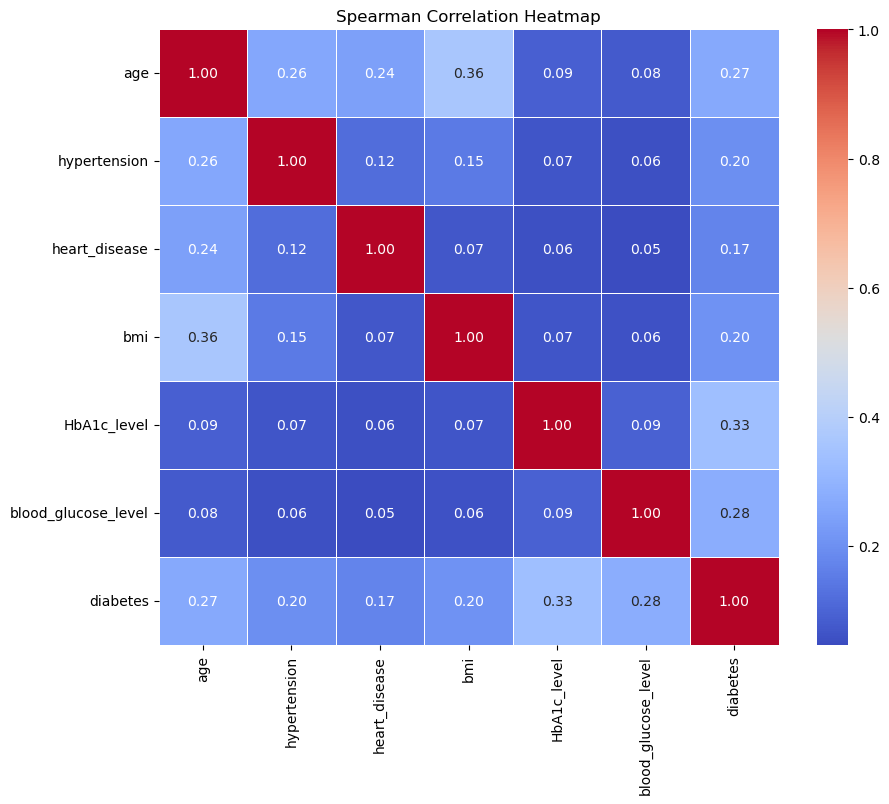

In [ ]:
correlation_matrix_spearman = diabetes.corr(method='spearman')

# Plot the correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix_spearman, cmap='coolwarm', annot=True, fmt='.2f', linewidths=0.5)
plt.title('Spearman Correlation Heatmap')
plt.show()

In [ ]:
categorical_columns = ['diabetes', 'gender', 'hypertension', 'heart_disease', 'smoking_history']

# Create an empty DataFrame to store the chi-squared test results
chi2_results = []

# Perform the chi-squared test for each combination of columns
for i in range(len(categorical_columns)):
    for j in range(i+1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]

        # Create the contingency table for the two columns
        contingency_table = pd.crosstab(diabetes[col1], diabetes[col2])

        # Perform the chi-squared test
        chi2, p, _, _ = stats.chi2_contingency(contingency_table)

        # Append the results to the chi2_results list
        chi2_results.append({'Column1': col1, 'Column2': col2, 'Chi2': chi2, 'P-value': p})

# Create a DataFrame from the chi2_results list
chi2_results_diabetes = pd.DataFrame(chi2_results)

# Display the chi-squared test results
print(chi2_results_diabetes)

         Column1          Column2         Chi2        P-value
0       diabetes           gender   137.508803   9.332862e-32
1       diabetes     hypertension  3674.034282   0.000000e+00
2       diabetes    heart_disease  2794.640121   0.000000e+00
3       diabetes  smoking_history  1721.994412   0.000000e+00
4         gender     hypertension    19.316722   1.107323e-05
5         gender    heart_disease   591.978943  9.299556e-131
6         gender  smoking_history  1087.880815  5.630805e-233
7   hypertension    heart_disease  1379.399851  6.293740e-302
8   hypertension  smoking_history  1524.407345   0.000000e+00
9  heart_disease  smoking_history  1127.302553  1.634541e-241


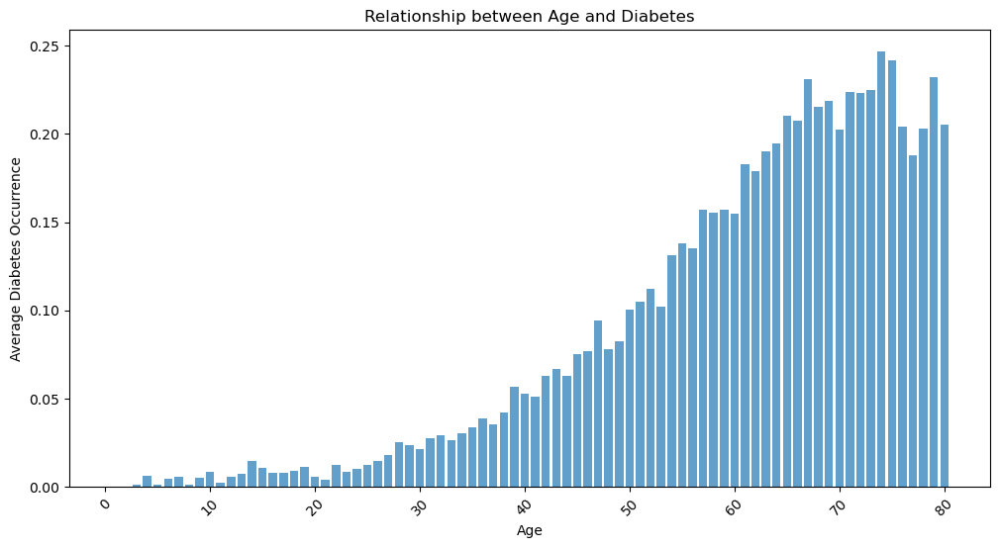

In [ ]:
age_diabetes_avg = diabetes.groupby('age')['diabetes'].mean()

# Plot the bar graph
plt.figure(figsize=(12, 6))
plt.bar(age_diabetes_avg.index, age_diabetes_avg.values, alpha=0.7)
plt.xlabel('Age')
plt.ylabel('Average Diabetes Occurrence')
plt.title('Relationship between Age and Diabetes')
plt.xticks(rotation=45)
plt.show()

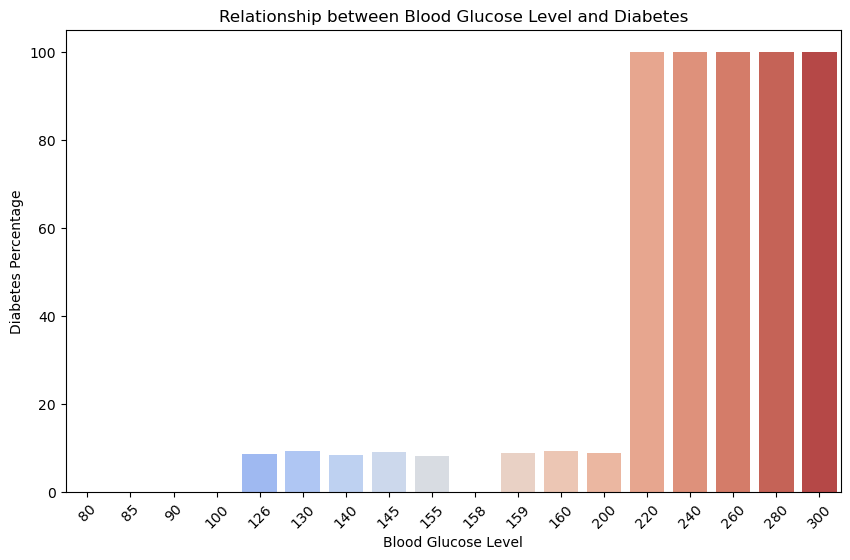

In [ ]:
glucose_diabetes_percentage = diabetes.groupby('blood_glucose_level')['diabetes'].mean().reset_index()
glucose_diabetes_percentage['diabetes'] *= 100  # Convert to percentage

# Create the bar graph using Seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='blood_glucose_level', y='diabetes', data=glucose_diabetes_percentage, palette='coolwarm')
plt.xlabel('Blood Glucose Level')
plt.ylabel('Diabetes Percentage')
plt.title('Relationship between Blood Glucose Level and Diabetes')
plt.xticks(rotation=45)
plt.show()

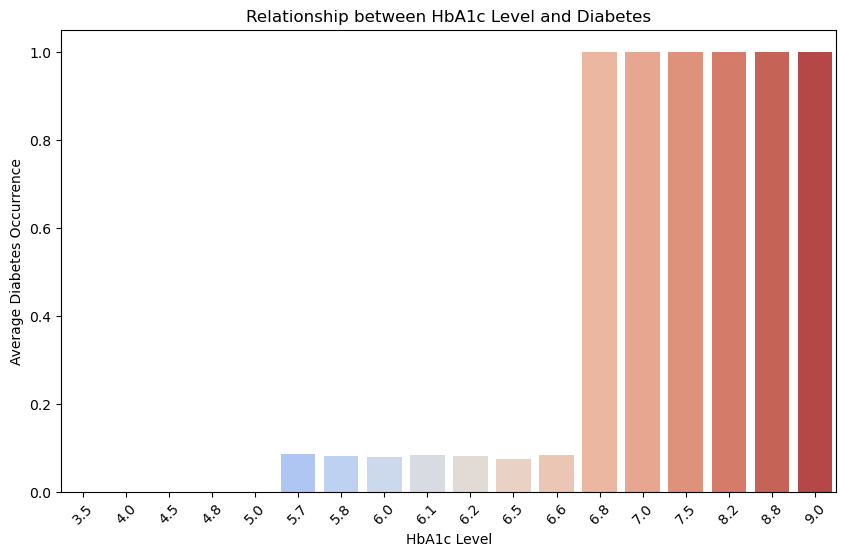

In [ ]:
hba1c_diabetes_avg = diabetes.groupby('HbA1c_level')['diabetes'].mean().reset_index()

# Create the bar graph using Seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='HbA1c_level', y='diabetes', data=hba1c_diabetes_avg, palette='coolwarm')
plt.xlabel('HbA1c Level')
plt.ylabel('Average Diabetes Occurrence')
plt.title('Relationship between HbA1c Level and Diabetes')
plt.xticks(rotation=45)
plt.show()

## Modelowanie

In [ ]:
X = diabetes.drop('diabetes', axis=1)
y = diabetes['diabetes']

In [ ]:
categorical_features = ['gender', 'smoking_history']
numeric_features = ['age', 'bmi', 'HbA1c_level', 'blood_glucose_level']

In [ ]:
preprocessor = ColumnTransformer(transformers=[
    ('cat', OneHotEncoder(), categorical_features),
    ('num', StandardScaler(), numeric_features)
])

In [ ]:
X_prep = preprocessor.fit_transform(X)

In [ ]:
# Get the updated column names for one-hot encoded features
cat_encoder = preprocessor.named_transformers_['cat']
one_hot_encoded_feature_names = cat_encoder.get_feature_names_out(input_features=categorical_features)

# Get the original numeric feature names
numeric_feature_names = numeric_features

# Concatenate the two lists of feature names to get the final list of column names after preprocessing
all_feature_names = list(one_hot_encoded_feature_names) + numeric_feature_names

# Convert X_prep (numpy array) to a pandas DataFrame with the updated column names
X_prep_diabetes = pd.DataFrame(X_prep, columns=all_feature_names)

# Now you can see the updated column names in X_prep_df
print(X_prep_diabetes.columns)

Index(['gender_Female', 'gender_Male', 'smoking_history_No Info',
       'smoking_history_current', 'smoking_history_ever',
       'smoking_history_former', 'smoking_history_never',
       'smoking_history_not current', 'age', 'bmi', 'HbA1c_level',
       'blood_glucose_level'],
      dtype='object')


In [ ]:
X_prep

array([[ 1.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         1.00000000e+00,  0.00000000e+00,  1.70171695e+00,
        -3.15032582e-01,  9.94425755e-01,  4.33832256e-02],
       [ 1.00000000e+00,  0.00000000e+00,  1.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  5.42359199e-01,
        -3.81181674e-04,  9.94425755e-01, -1.42310405e+00],
       [ 0.00000000e+00,  1.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         1.00000000e+00,  0.00000000e+00, -6.16998550e-01,
        -3.81181674e-04,  1.55909066e-01,  4.83329407e-01],
       [ 1.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         1.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00, -2.60273089e-01,
        -5.72071753e-01, -4.96270581e-01,  4.10005044e-01],
       [ 0.00000000e+00,  1.00000000e+00,  0.0000000

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_prep, y, test_size=0.2, random_state=42)

In [ ]:
param_grid_l1_l2 = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1.0, 10.0]
}

# Porównanie solvera 'liblinear' z regularyzacją L1 i L2
model_regression_l1_l2 = LogisticRegression(solver='liblinear', class_weight = 'balanced')
gridSearch_l1_l2 = GridSearchCV(model_regression_l1_l2, param_grid_l1_l2, cv=5, scoring='recall')
gridSearch_l1_l2.fit(X_train, y_train)

print("Najlepsze wyniki dla różnych regularyzacji:")
print("Solver 'liblinear' z regularyzacją L1 i L2:")
print("Najlepsza dokładność:", gridSearch_l1_l2.best_score_)
print("Najlepsze parametry:", gridSearch_l1_l2.best_params_)

Najlepsze wyniki dla różnych regularyzacji:
Solver 'liblinear' z regularyzacją L1 i L2:
Najlepsza dokładność: 0.8820029054834094
Najlepsze parametry: {'C': 0.01, 'penalty': 'l2'}


In [ ]:
y_prob = model.predict_proba(X_test)[:,1]
threshold =0.2
y_pred =( y_prob >= threshold).astype(int)

In [ ]:
recall =recall_score(y_test, y_pred)

In [ ]:
recall

0.968625213918996

In [ ]:
param_grid_elasticnet = {
    'penalty': ['elasticnet'],
    'C': [0.01, 0.1, 1.0, 10.0],
    'l1_ratio': [0.25, 0.5, 0.75]  # l1_ratio ustawiamy tylko dla Elastic Net
}

# Porównanie solvera 'saga' z regularyzacją Elastic Net
model_regression_elasticnet = LogisticRegression(solver='saga', class_weight = 'balanced')
gridSearch_elasticnet = GridSearchCV(model_regression_elasticnet, param_grid_elasticnet, cv=5, scoring='recall')
gridSearch_elasticnet.fit(X_train, y_train)

print("Solver 'saga' z regularyzacją Elastic Net:")
print("Najlepsza dokładność:", gridSearch_elasticnet.best_score_)
print("Najlepsze parametry:", gridSearch_elasticnet.best_params_)

Solver 'saga' z regularyzacją Elastic Net:
Najlepsza dokładność: 0.880665499317819
Najlepsze parametry: {'C': 0.1, 'l1_ratio': 0.75, 'penalty': 'elasticnet'}


In [ ]:
model_weight = LogisticRegression(class_weight = 'balanced')
model_weight.fit(X_train, y_train)

LogisticRegression(class_weight='balanced')

In [ ]:
y_pred_weight = model_weight.predict(X_test)

In [ ]:
recall_pd =recall_score(y_test, y_pred_weight)
recall_pd

0.8796349115801483

In [ ]:
param_grid_none = {
    'penalty': ['none'],
    'C': [0.01, 0.1, 1.0, 10.0]
}

# Porównanie bez regularyzacji
model_regression_none = LogisticRegression()
gridSearch_none = GridSearchCV(model_regression_none, param_grid_none, cv=5, scoring='recall')
gridSearch_none.fit(X_train, y_train)

print("Bez regularyzacji:")
print("Najlepsza dokładność:", gridSearch_none.best_score_)
print("Najlepsze parametry:", gridSearch_none.best_params_)

Bez regularyzacji:
Najlepsza dokładność: 0.6231237813264692
Najlepsze parametry: {'C': 0.01, 'penalty': 'none'}


In [ ]:
model_regression_l2 = LogisticRegression(solver='liblinear', class_weight = 'balanced', C = 0.01, penalty = 'l2')
model_regression_l2.fit(X_train, y_train)

LogisticRegression(C=0.01, class_weight='balanced', solver='liblinear')

In [ ]:
model_regression_l2.coef_

array([[-0.89430821, -0.54845976, -0.70448083, -0.05118036, -0.0927151 ,
        -0.11695299, -0.22112698, -0.25631171,  1.1398655 ,  0.60600583,
         2.1087791 ,  1.22529421]])

In [ ]:
## 'gender_Female', 'gender_Male', 'smoking_history_No Info',
       ##'smoking_history_current', 'smoking_history_ever',
       ##'smoking_history_former', 'smoking_history_never',
       ##'smoking_history_not current', 'age', 'bmi', 'HbA1c_level',
       ##'blood_glucose_level'

In [ ]:
diabetes3 = diabetes.drop('smoking_history', axis = 1)

In [ ]:
X3 = diabetes3.drop('diabetes', axis=1)
y3 = diabetes3['diabetes']

In [ ]:
categorical_features = ['gender']
numeric_features = ['age', 'bmi', 'HbA1c_level', 'blood_glucose_level']

In [ ]:
preprocessor3 = ColumnTransformer(transformers=[
    ('cat', OneHotEncoder(), categorical_features),
    ('num', StandardScaler(), numeric_features)
])

In [ ]:
X_prep3 = preprocessor3.fit_transform(X3)

In [ ]:
# Get the updated column names for one-hot encoded features
cat_encoder = preprocessor3.named_transformers_['cat']
one_hot_encoded_feature_names = cat_encoder.get_feature_names_out(input_features=categorical_features)

# Get the original numeric feature names
numeric_feature_names = numeric_features

# Concatenate the two lists of feature names to get the final list of column names after preprocessing
all_feature_names = list(one_hot_encoded_feature_names) + numeric_feature_names

# Convert X_prep (numpy array) to a pandas DataFrame with the updated column names
X_prep_diabetes3 = pd.DataFrame(X_prep3, columns=all_feature_names)

# Now you can see the updated column names in X_prep_df
print(X_prep_diabetes3.columns)

Index(['gender_Female', 'gender_Male', 'age', 'bmi', 'HbA1c_level',
       'blood_glucose_level'],
      dtype='object')


In [ ]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X_prep3, y3, test_size=0.2, random_state=42)

In [ ]:
model_regression_l2_3 = LogisticRegression(solver='liblinear', class_weight = 'balanced', C = 0.01, penalty = 'l2')
model_regression_l2_3.fit(X_train3, y_train3)

LogisticRegression(C=0.01, class_weight='balanced', solver='liblinear')

In [ ]:
y_pred3 = model_regression_l2_3.predict(X_test3)

In [ ]:
recall_3 =recall_score(y_test3, y_pred3)
recall_3

0.8830576155162578

In [ ]:
y_train_pred3 = model_regression_l2_3.predict(X_train3)

In [ ]:
recall_3_train =recall_score(y_train3, y_train_pred3)
recall_3_train

0.878585228117105

In [ ]:
model_regression_l2_3.coef_

array([[-0.99661375, -0.64511048,  1.15922759,  0.62155701,  2.10245131,
         1.22304772]])

In [ ]:
# gender_Female', 'gender_Male', 'age', 'bmi', 'HbA1c_level','blood_glucose_level'

In [ ]:
Tree = DecisionTreeClassifier(class_weight = 'balanced')

param = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [i for i in range(1, 10)],
    'min_samples_leaf': [i for i in range(1, 10)]}

gridSearchTree = GridSearchCV(Tree, param, cv=5, scoring='recall')

In [ ]:
gridSearchTree.fit(X_train3, y_train3)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(class_weight='balanced'),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9]},
             scoring='recall')

In [ ]:
print("Najlepszy estymator:", gridSearchTree.best_estimator_)

Najlepszy estymator: DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=5)


In [ ]:
Tree1 = DecisionTreeClassifier(max_depth=9, min_samples_leaf=9, class_weight = 'balanced')

In [ ]:
Tree1.fit(X_train3, y_train3)

DecisionTreeClassifier(class_weight='balanced', max_depth=9, min_samples_leaf=9)

In [ ]:
y_pred3_tree = Tree1.predict(X_test3)

In [ ]:
recall_3_tree =recall_score(y_test3, y_pred3_tree)
recall_3_tree

0.9224187107815174

In [ ]:
y_train_pred3_tree = Tree1.predict(X_train3)

In [ ]:
recall_3_tree_train =recall_score(y_train3, y_train_pred3_tree)
recall_3_tree_train

0.9249517015901323

In [ ]:
# W przypadku dostępnych danych najlepszym modelem okazało się drzewo decyzyjne z uwzględnieniem zbalansowania wag klas